In [4]:
"""
This notebook aims to validate topic models built on three different data sets.
The preprocessing, modeling, and validation routines are all the same as those detailed in the
baseline model notebooks.
The first dataset consists of 12k opinions from after 1950.
The second consists of 12k opinions from only Illinois.
The third consists of 12 opinions from only Illinois and after 1950.
"""

import pandas as pd

%matplotlib inline
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import os
import time

import spacy

from gensim.corpora.dictionary import Dictionary
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel

import networkx as nx

from sklearn.neighbors import NearestNeighbors

import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

data_1_header = 'cases_after1950_12k'
data_2_header = 'cases_IL_12k'
data_3_header = 'cases_IL_after1950_12k'

In [6]:
# PREPROCESS (if necessary; otherwise skip to next cell):

nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])

for data_header in [data_1_header, data_2_header, data_3_header]:
    data_raw = pd.read_csv('../data_uncompressed/'+ data_header + '_raw.csv')
    start = time.time()
    opinions = []
    print('Beginning preprocessing of opinions...')
    for i, row in data_raw.iterrows():
        case_id = row.case_id
        juris = row.jurisdiction
        text = row.opinion
        court = row.court_name
        decision_year = row.decision_year
        doc = nlp(text)
        doc = [t for t in doc if not t.is_stop]
        doc = [t.lemma_ for t in doc if t.pos_ in ['NOUN', 'ADJ', 'VERB', 'ADV']]
        opinions.append((case_id, juris, court, decision_year, doc))
        if i%1000==0:
            print(f'Done with {i} opinions.')
            print(f'Time elapsed: {round(time.time()-start)}')
            print('#######################################')
    print('Done preprocessing. Took {} seconds.'.format(round(time.time()-start)))

    data_raw = None

    df = pd.DataFrame(opinions, columns=['case_id', 'jurisdiction', 'court', 'decision_year', 'opinion'])
    opinions = None
    df.to_csv('../data_uncompressed/'+ data_header + '_processed.csv', index=False)

    df = None
    
nlp = None    
    
    

Beginning preprocessing of opinions...
Done with 0 opinions.
Time elapsed: 1
#######################################
Done with 1000 opinions.
Time elapsed: 94
#######################################
Done with 2000 opinions.
Time elapsed: 183
#######################################
Done with 3000 opinions.
Time elapsed: 270
#######################################
Done with 4000 opinions.
Time elapsed: 363
#######################################
Done with 5000 opinions.
Time elapsed: 525
#######################################
Done with 6000 opinions.
Time elapsed: 696
#######################################
Done with 7000 opinions.
Time elapsed: 856
#######################################
Done with 8000 opinions.
Time elapsed: 1025
#######################################
Done with 9000 opinions.
Time elapsed: 1174
#######################################
Done with 10000 opinions.
Time elapsed: 1332
#######################################
Done with 11000 opinions.
Time elapsed: 1484
#####

In [7]:
def parse_list_col(df, col_to_parse):
    df.loc[:, col_to_parse] = df[col_to_parse].apply(lambda x: x.strip('[]').split(','))
    df.loc[:, col_to_parse] = df[col_to_parse].apply(lambda x: [t.strip().strip("'") for t in x])
    
# HELPER FUNCTIONS FOR PERPLEXITY, COHERENCE, AND WORDCLOUDS
def get_perplexity(model, corpus):
    return 2**(-model.log_perplexity(corpus))

def get_coherence(model, texts, dictionary):
    # texts should be lists of terms, not the BoW representation
    coherence_model = CoherenceModel(model=model, texts=texts, 
                                 dictionary=dictionary, coherence='c_v')
    return coherence_model.get_coherence()

def get_wordclouds(model, num_words=250, save_file=None, num_topics=10):
    for i, topic in  enumerate(model.show_topics(num_topics=num_topics, num_words=num_words, formatted=False)):
        topic_dict = {w:v for (w,v) in topic[1]}

        wordcloud = WordCloud(width = 800, height = 800, 
                        background_color ='white',
                        min_font_size = 10).generate_from_frequencies(topic_dict) 

        # plot the WordCloud image                        
        plt.figure(figsize = (8, 8), facecolor = None) 
        plt.imshow(wordcloud) 
        plt.axis("off") 
        plt.tight_layout(pad = 0) 
        if save_file:
            path = os.path.join(save_file, f'topic_{i+1}.png')
            plt.savefig(path)
        else:
            plt.show()

# HELPER FUNCTIONS FOR CITATION-GRAPH KNN VALIDATION

def unpack_topics(df, num_topics):
    new_df = pd.DataFrame(columns=['case_id']+[f'topic_{i}' for i in range(num_topics)])
    for i, row in df.iterrows():
        new_row = {}
        new_row['case_id'] = row.case_id
        topics = row.topic_vector
        for t in topics:
            topic_num = t[0]
            topic_val = t[1]
            new_row[f'topic_{topic_num}'] = topic_val
        new_df = new_df.append(new_row, ignore_index=True)
    new_df = new_df.fillna(0)
    new_df['case_id'] = new_df['case_id'].apply(lambda x: int(x))
    return new_df

def get_nearest_neighbors(df, n_neighbors, nn_model):
    knearest = nn_model.kneighbors(n_neighbors=n_neighbors, return_distance=False)
    for k in range(n_neighbors):
        df[f'nn_{k}'] = [df.case_id[x[k]] for x in knearest]
        
def edge_length(row, k, graph):
    return nx.shortest_path_length(graph, row['case_id'], row[f'nn_{k}'])

def get_edge_lengths(df, n_neighbors, graph):
    for k in range(n_neighbors):
        df[f'cite_distance_{k}'] = df.apply(edge_length, k=k, graph=graph, axis=1)
        
def get_min_cite_dist(row, n_neighbors):
    return int(row[[f'cite_distance_{k}' for k in range(n_neighbors)]].min())

def get_mean_cite_dist(row, n_neighbors):
    return row[[f'cite_distance_{k}' for k in range(n_neighbors)]].mean()

def get_max_cite_dist(row, n_neighbors):
    return int(row[[f'cite_distance_{k}' for k in range(n_neighbors)]].max())

def knn_citation_validation(test_ids, lda_model, test_corpus, graph, n_neighbors):
    test_data = pd.DataFrame(test_ids, columns=['case_id'])
    test_data['topic_vector'] = [lda_model[op] for op in test_corpus]
    nodes = list(graph.nodes)
    test_data = test_data.loc[test_data.case_id.isin(nodes),:]
    nodes = None
    test_data.reset_index(drop=True, inplace=True)
    
    test_data = unpack_topics(test_data, num_topics=15)
    
    nn = NearestNeighbors()

    X = test_data.drop(columns='case_id').values

    nn.fit(X)
    
    get_nearest_neighbors(test_data, n_neighbors, nn)
    
    get_edge_lengths(test_data, n_neighbors, graph)
    
    test_data['min_cite_dist'] = test_data.apply(get_min_cite_dist, axis=1, n_neighbors=n_neighbors)
    test_data['mean_cite_dist'] = test_data.apply(get_mean_cite_dist, axis=1, n_neighbors=n_neighbors)
    test_data['max_cite_dist'] = test_data.apply(get_max_cite_dist, axis=1, n_neighbors=n_neighbors)
    
    return test_data

In [8]:
# Obtain largest connected component of citation graph and other static variables.

G = nx.read_gpickle('../citation_graph.gpickle')
big_subgraph = nx.subgraph(G, list(nx.connected_components(G))[0])
G = None
seed = 9
num_topics = [3, 5, 10, 15, 20]
output_header = '../validation_output'

BEGINNING VALIDATION OF cases_after1950_12k...
Processing model with 3 topics...
Model training done. Time: 21
Computing perplexity on train set.
Done. Time: 35
Computing perplexity on test set.
Done. Time: 10
Computing coherence on train set.
Done. Time: 61
Computing coherence on test set.
Done. Time: 15
Computing citation graph validation metrics.
Done. Time: 84
Saving wordclouds...
Done. Time: 7
Done with full iteration. TOTAL TIME: 233
######################################
Processing model with 5 topics...
Model training done. Time: 21
Computing perplexity on train set.
Done. Time: 36
Computing perplexity on test set.
Done. Time: 9
Computing coherence on train set.
Done. Time: 67
Computing coherence on test set.
Done. Time: 17
Computing citation graph validation metrics.
Done. Time: 78
Saving wordclouds...
Done. Time: 11
Done with full iteration. TOTAL TIME: 241
######################################
Processing model with 10 topics...
Model training done. Time: 22
Computing perple

/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 35
Done with full iteration. TOTAL TIME: 286
######################################
Processing model with 20 topics...
Model training done. Time: 24
Computing perplexity on train set.
Done. Time: 39
Computing perplexity on test set.
Done. Time: 10
Computing coherence on train set.
Done. Time: 105
Computing coherence on test set.
Done. Time: 32
Computing citation graph validation metrics.
Done. Time: 66
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 46
Done with full iteration. TOTAL TIME: 321
######################################
FINISHED. TOTAL TIME ELAPSED: 1342.7934000492096
BEGINNING VALIDATION OF cases_IL_12k...
Processing model with 3 topics...
Model training done. Time: 19
Computing perplexity on train set.
Done. Time: 33
Computing perplexity on test set.
Done. Time: 8
Computing coherence on train set.
Done. Time: 52
Computing coherence on test set.
Done. Time: 14
Computing citation graph validation metrics.
Done. Time: 30
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 7
Done with full iteration. TOTAL TIME: 164
######################################
Processing model with 5 topics...
Model training done. Time: 20
Computing perplexity on train set.
Done. Time: 33
Computing perplexity on test set.
Done. Time: 8
Computing coherence on train set.
Done. Time: 58
Computing coherence on test set.
Done. Time: 16
Computing citation graph validation metrics.
Done. Time: 27
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 12
Done with full iteration. TOTAL TIME: 174
######################################
Processing model with 10 topics...
Model training done. Time: 20
Computing perplexity on train set.
Done. Time: 34
Computing perplexity on test set.
Done. Time: 8
Computing coherence on train set.
Done. Time: 71
Computing coherence on test set.
Done. Time: 19
Computing citation graph validation metrics.
Done. Time: 27
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 24
Done with full iteration. TOTAL TIME: 203
######################################
Processing model with 15 topics...
Model training done. Time: 22
Computing perplexity on train set.
Done. Time: 34
Computing perplexity on test set.
Done. Time: 9
Computing coherence on train set.
Done. Time: 80
Computing coherence on test set.
Done. Time: 22
Computing citation graph validation metrics.
Done. Time: 26
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 34
Done with full iteration. TOTAL TIME: 227
######################################
Processing model with 20 topics...
Model training done. Time: 22
Computing perplexity on train set.
Done. Time: 35
Computing perplexity on test set.
Done. Time: 9
Computing coherence on train set.
Done. Time: 88
Computing coherence on test set.
Done. Time: 25
Computing citation graph validation metrics.
Done. Time: 26
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 45
Done with full iteration. TOTAL TIME: 251
######################################
FINISHED. TOTAL TIME ELAPSED: 1017.7291867733002
BEGINNING VALIDATION OF cases_IL_after1950_12k...
Processing model with 3 topics...
Model training done. Time: 22
Computing perplexity on train set.
Done. Time: 40
Computing perplexity on test set.
Done. Time: 10
Computing coherence on train set.
Done. Time: 76
Computing coherence on test set.
Done. Time: 21
Computing citation graph validation metrics.
Done. Time: 31
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 7
Done with full iteration. TOTAL TIME: 207
######################################
Processing model with 5 topics...
Model training done. Time: 23
Computing perplexity on train set.
Done. Time: 41
Computing perplexity on test set.
Done. Time: 10
Computing coherence on train set.
Done. Time: 109
Computing coherence on test set.
Done. Time: 23
Computing citation graph validation metrics.
Done. Time: 31
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 12
Done with full iteration. TOTAL TIME: 248
######################################
Processing model with 10 topics...
Model training done. Time: 24
Computing perplexity on train set.
Done. Time: 42
Computing perplexity on test set.
Done. Time: 11
Computing coherence on train set.
Done. Time: 99
Computing coherence on test set.
Done. Time: 28
Computing citation graph validation metrics.
Done. Time: 30
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 23
Done with full iteration. TOTAL TIME: 256
######################################
Processing model with 15 topics...
Model training done. Time: 25
Computing perplexity on train set.
Done. Time: 43
Computing perplexity on test set.
Done. Time: 11
Computing coherence on train set.
Done. Time: 112
Computing coherence on test set.
Done. Time: 31
Computing citation graph validation metrics.
Done. Time: 30
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 34
Done with full iteration. TOTAL TIME: 286
######################################
Processing model with 20 topics...
Model training done. Time: 26
Computing perplexity on train set.
Done. Time: 43
Computing perplexity on test set.
Done. Time: 11
Computing coherence on train set.
Done. Time: 121
Computing coherence on test set.
Done. Time: 34
Computing citation graph validation metrics.
Done. Time: 30
Saving wordclouds...


/Applications/anaconda3/envs/insight/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Done. Time: 46
Done with full iteration. TOTAL TIME: 311
######################################
FINISHED. TOTAL TIME ELAPSED: 1307.3428308963776


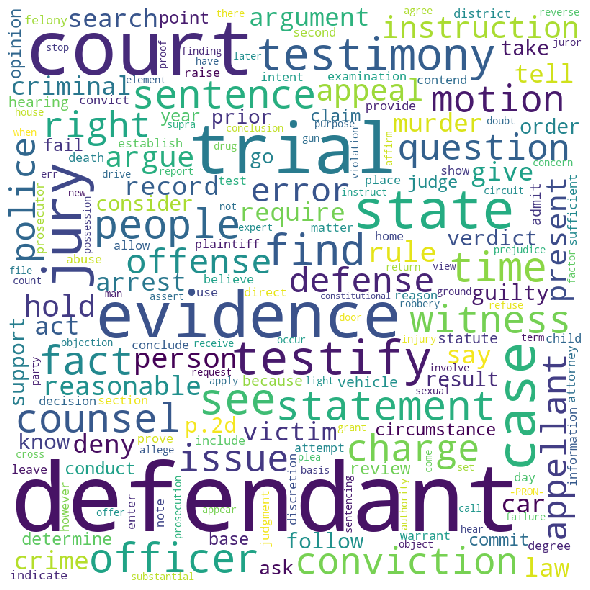

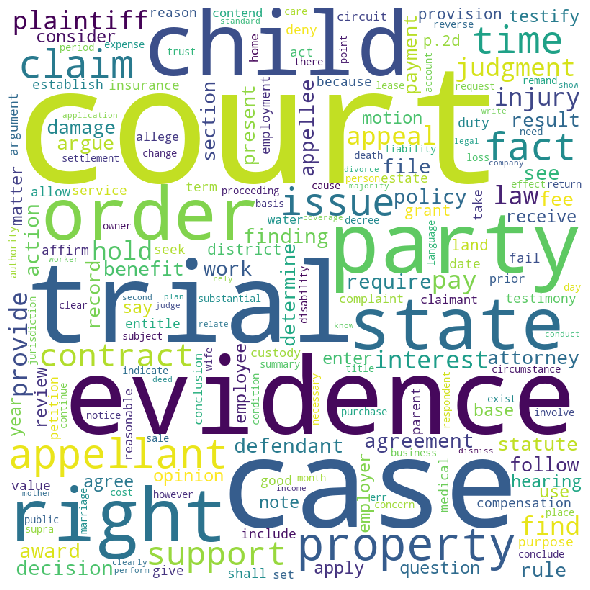

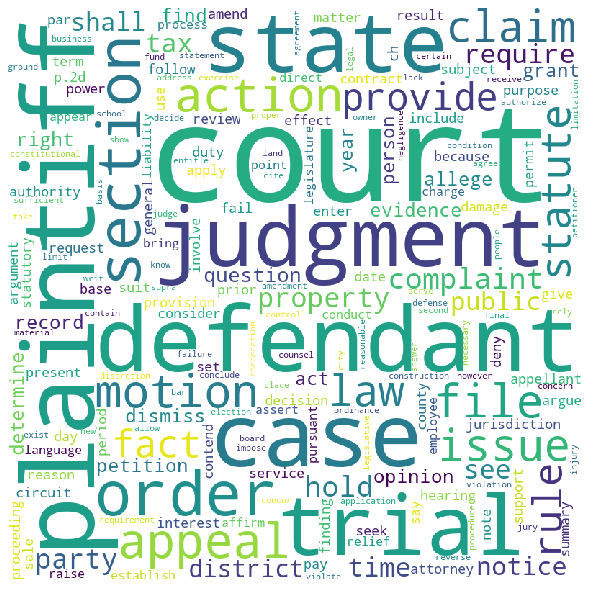

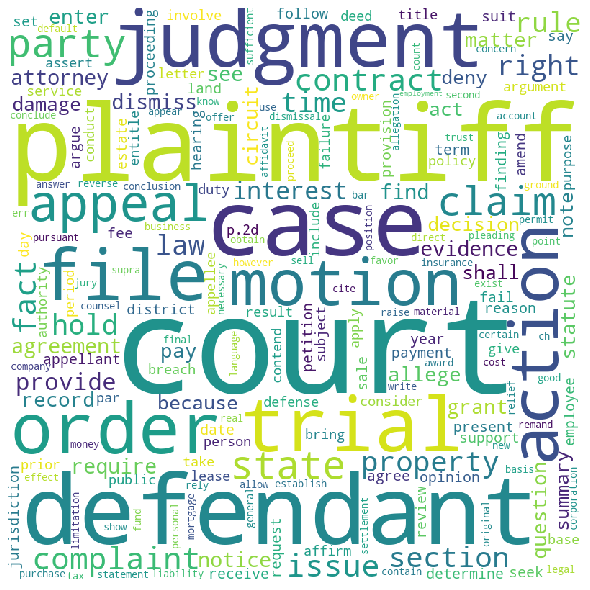

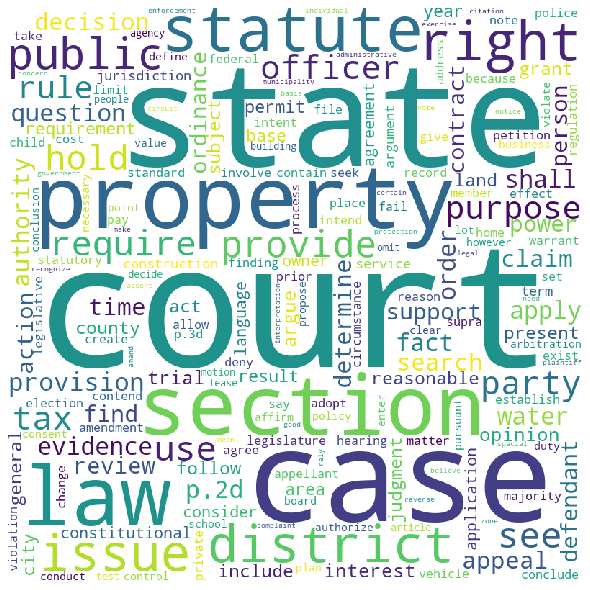

...

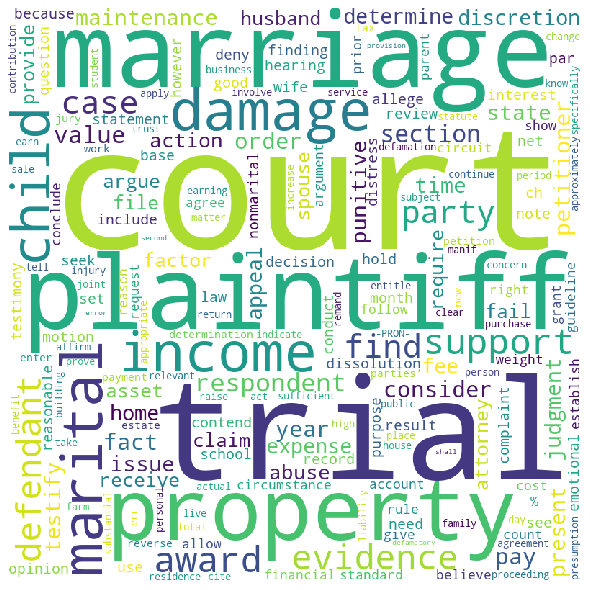

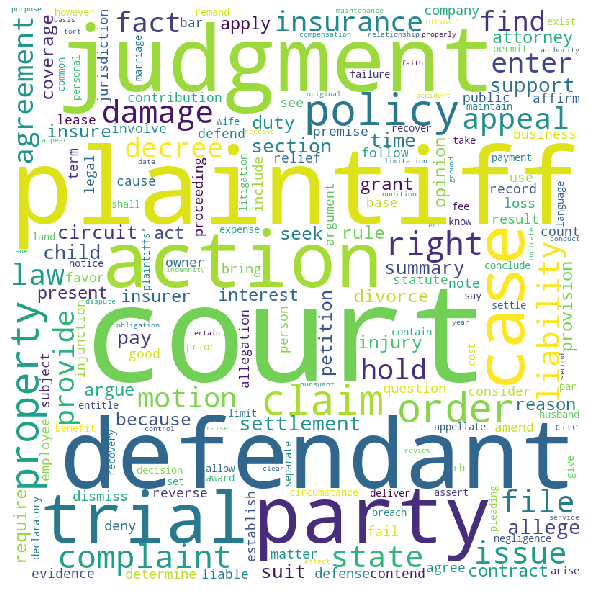

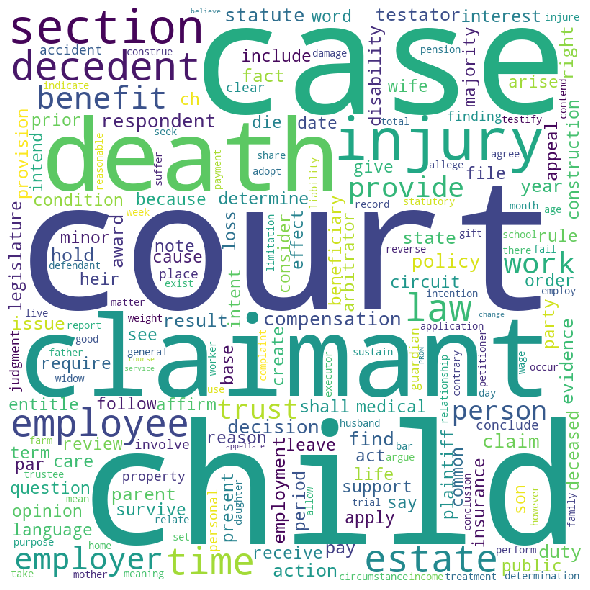

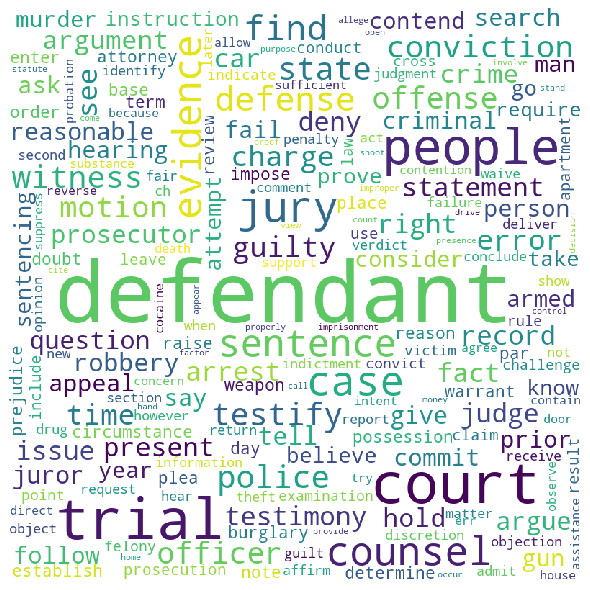

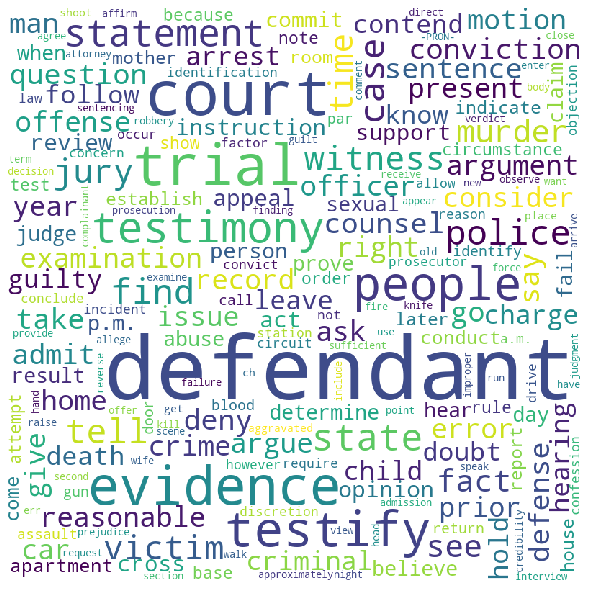

In [9]:
for data_header in [data_1_header, data_2_header, data_3_header]:
    print(f'BEGINNING VALIDATION OF {data_header}...')
    data = pd.read_csv('../data_uncompressed/' + data_header + '_processed.csv')
    parse_list_col(data, 'opinion')
    
    # Shuffle data to ensure jurisdictions are mixed properly.

    data = data.sample(frac=1, random_state=seed).reset_index(drop=True)

    # Split into train/test sets

    split = int(0.8*data.shape[0])
    train_ops = data.loc[:split, 'opinion']
    test_ops = data.loc[split:, 'opinion']

    # Build gensim dictionary

    op_dictionary = Dictionary(train_ops.to_list())
    train_op_corpus = [op_dictionary.doc2bow(op) for op in train_ops.to_list()]
    test_op_corpus = [op_dictionary.doc2bow(op) for op in test_ops.to_list()]
    
    # BEGIN VALIDATION. THIS WILL TAKE SOME TIME.

    train_perplexity = []
    test_perplexity = []
    train_coherence = []
    test_coherence = []
    min_cite_dist_mean = []
    min_cite_dist_sd = []
    avg_cite_dist_mean = []
    avg_cite_dist_sd = []
    max_cite_dist_mean = []
    max_cite_dist_sd = []

    test_ids = data.loc[split:, 'case_id'].to_list()
    data = None

    wordcloud_header = '../wordclouds/' + data_header
    os.mkdir(wordcloud_header)

    start = time.time()

    for nt in num_topics:
        iter_start=time.time()
        print(f'Processing model with {nt} topics...')
        temp_time= time.time()
        lda = LdaModel(train_op_corpus, id2word=op_dictionary, num_topics=nt)
        print(f'Model training done. Time: {round(time.time()-temp_time)}')
        print('Computing perplexity on train set.')
        temp_time= time.time()
        train_perplexity.append(get_perplexity(lda, train_op_corpus))
        print(f'Done. Time: {round(time.time()-temp_time)}')
        print('Computing perplexity on test set.')
        temp_time= time.time()
        test_perplexity.append(get_perplexity(lda, test_op_corpus))
        print(f'Done. Time: {round(time.time()-temp_time)}')
        print('Computing coherence on train set.')
        temp_time= time.time()
        train_coherence.append(get_coherence(lda, train_ops.to_list(), op_dictionary))
        print(f'Done. Time: {round(time.time()-temp_time)}')
        print('Computing coherence on test set.')
        temp_time= time.time()
        test_coherence.append(get_coherence(lda, test_ops.to_list(), op_dictionary))
        print(f'Done. Time: {round(time.time()-temp_time)}')
        print('Computing citation graph validation metrics.')
        temp_time= time.time()
        metric_cols = ['min_cite_dist', 'mean_cite_dist', 'max_cite_dist']
        citation_dist_results = knn_citation_validation(test_ids, lda, test_op_corpus, big_subgraph, 5)[metric_cols]
        min_cite_dist_mean.append(citation_dist_results.min_cite_dist.mean())
        min_cite_dist_sd.append(citation_dist_results.min_cite_dist.std())
        avg_cite_dist_mean.append(citation_dist_results.mean_cite_dist.mean())
        avg_cite_dist_sd.append(citation_dist_results.mean_cite_dist.std())
        max_cite_dist_mean.append(citation_dist_results.max_cite_dist.mean())
        max_cite_dist_sd.append(citation_dist_results.max_cite_dist.std())
        print(f'Done. Time: {round(time.time()-temp_time)}')
        print('Saving wordclouds...')
        temp_time= time.time()
        os.mkdir(os.path.join(wordcloud_header, f'num_topics_{nt}'))
        get_wordclouds(lda, save_file=os.path.join(wordcloud_header, f'num_topics_{nt}'), num_topics=nt)
        print(f'Done. Time: {round(time.time()-temp_time)}')
        print(f'Done with full iteration. TOTAL TIME: {round(time.time()-iter_start)}')
        print('######################################')
    print(f'FINISHED. TOTAL TIME ELAPSED: {time.time()-start}')

    results_df = pd.DataFrame({'num_topics': num_topics,
                              'train_perplexity': train_perplexity,
                              'test_perplexity': test_perplexity,
                              'train_coherence': train_coherence,
                              'test_coherence': test_coherence,
                              'min_cite_dist_mean': min_cite_dist_mean,
                              'min_cite_dist_sd': min_cite_dist_sd,
                              'avg_cite_dist_mean': avg_cite_dist_mean,
                              'avg_cite_dist_sd': avg_cite_dist_sd,
                              'max_cite_dist_mean': max_cite_dist_mean,
                              'max_cite_dist_sd': max_cite_dist_sd})

    results_df.to_csv(os.path.join(output_header, data_header + '.csv'), index=False)

    train_ops = None
    train_op_corpus = None
    test_ops = None
    test_op_corpus = None
    op_dictionary = None
    test_ids = None
    